In [1]:
import numpy as np
import pandas as pd
import matplotlib as plt

data = pd.read_csv(r'E:\AB\MACHINE LEARNING THINGS\Linear Regression\NY stock exchange\prices-split-adjusted.csv')

In [2]:
df=pd.DataFrame(data)
df

,date,symbol,open,close,low,high,volume
0,2016-01-05,WLTW,123.430000,125.839996,122.309998,126.250000,2163600.0
1,2016-01-06,WLTW,125.239998,119.980003,119.940002,125.540001,2386400.0
2,2016-01-07,WLTW,116.379997,114.949997,114.930000,119.739998,2489500.0
3,2016-01-08,WLTW,115.480003,116.620003,113.500000,117.440002,2006300.0
4,2016-01-11,WLTW,117.010002,114.970001,114.089996,117.330002,1408600.0
...,...,...,...,...,...,...,...
851259,2016-12-30,ZBH,103.309998,103.199997,102.849998,103.930000,973800.0
851260,2016-12-30,ZION,43.070000,43.040001,42.689999,43.310001,1938100.0
851261,2016-12-30,ZTS,53.639999,53.529999,53.270000,53.740002,1701200.0
851262,2016-12-30,AIV,44.730000,45.450001,44.410000,45.590000,1380900.0


In [3]:
df=df.drop('symbol',axis=1)
dfr = df

In [7]:
dfr=dfr.drop('close',axis=1)
dfr

,open,volume
0,123.430000,2163600.0
1,125.239998,2386400.0
2,116.379997,2489500.0
3,115.480003,2006300.0
4,117.010002,1408600.0
...,...,...
851259,103.309998,973800.0
851260,43.070000,1938100.0
851261,53.639999,1701200.0
851262,44.730000,1380900.0


In [8]:
y = df['close']
y

0         125.839996
1         119.980003
2         114.949997
3         116.620003
4         114.970001
             ...    
851259    103.199997
851260     43.040001
851261     53.529999
851262     45.450001
851263     53.630001
Name: close, Length: 851264, dtype: float64

In [89]:
dfr=dfr.drop('date',axis=1)

In [9]:
dfr

,open,volume
0,123.430000,2163600.0
1,125.239998,2386400.0
2,116.379997,2489500.0
3,115.480003,2006300.0
4,117.010002,1408600.0
...,...,...
851259,103.309998,973800.0
851260,43.070000,1938100.0
851261,53.639999,1701200.0
851262,44.730000,1380900.0


In [16]:
y

0         125.839996
1         119.980003
2         114.949997
3         116.620003
4         114.970001
             ...    
851259    103.199997
851260     43.040001
851261     53.529999
851262     45.450001
851263     53.630001
Name: close, Length: 851264, dtype: float64

In [20]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(dfr), columns=dfr.columns)
X.head()

,open,volume
0,0.076934,0.002517
1,0.078078,0.002776
2,0.072480,0.002896
3,0.071911,0.002334
4,0.072878,0.001639


In [21]:
w = np.array([1,1])
b=2
X

,open,volume
0,0.076934,0.002517
1,0.078078,0.002776
2,0.072480,0.002896
3,0.071911,0.002334
4,0.072878,0.001639
...,...,...
851259,0.064222,0.001133
851260,0.026163,0.002255
851261,0.032841,0.001979
851262,0.027212,0.001606


In [22]:
X = X.to_numpy()
X

array([[0.07693426, 0.00251686],
       [0.07807781, 0.00277603],
       [0.07248007, 0.00289597],
       ...,
       [0.03284095, 0.00197896],
       [0.02721162, 0.00160636],
       [0.03319476, 0.00082022]])

In [23]:
def cost_func(X,y,w,b):
    
    cf=0
    fwb=0
    
    m = X.shape[0]
    for i in range(m):
        fwb= np.dot(X[i],w)+b
        cf += (fwb-y[i])**2
    cf = cf/(2*m)
    return cf

In [24]:
import math
print(f'Cost function is : {cost_func(X,y,w,b)} ')

Cost function is : 4806.515095777458 


In [25]:
def deriv(X,y,w,b):
    
    m = X.shape[0]
    n = X.shape[1]
    dw = np.zeros((n,))
    db = 0.
    cf=0
    
    for i in range(m):
        fwb = np.dot(X[i],w)+b 
        cf = fwb-y[i]
        for j in range(n):
            dw[j]+= cf*X[i][j]
        db+=cf
    dw=dw/m
    db=db/m
    
    return dw,db

In [26]:
def grad_desc(X,y,w,b,iters):
    
    gd=0
    cf=0
    fwb=0
    ap = 1.98
    dw=0
    db=0
    hist = []
    
    for i in range(iters):
        dw,db = deriv(X,y,w,b)
        w = w-(ap*dw)
        b = b-(ap*db)
        
        if(i<2000):
            hist.append(cost_func(X,y,w,b))
            
        if i% math.ceil((iters-1) / 10) == 0:
            print(f"Iteration {i:4d}: Cost {hist[-1]:8.2f}   ")
        
    return w,b,hist

In [27]:
it = 1001
b=0
w_final, b_final, J_hist = grad_desc(X, y, w, b,it)                                         
print(f"b,w found by gradient descent: {b_final:0.2f},{w_final} ")
m,_ = X.shape
for i in range(m):
    print(f"prediction: {np.dot(X[i], w_final) + b_final:0.2f}, target value: {y[i]}")

Iteration    0: Cost  4838.96   
Iteration  100: Cost  1209.32   
Iteration  200: Cost   468.13   
Iteration  300: Cost   190.89   
Iteration  400: Cost    78.59   
Iteration  500: Cost    32.77   
Iteration  600: Cost    14.06   
Iteration  700: Cost     6.41   
Iteration  800: Cost     3.28   
Iteration  900: Cost     1.99   
Iteration 1000: Cost     1.45   
b,w found by gradient descent: 2.77,[1562.64861028  -45.58574081] 
prediction: 122.88, target value: 125.839996
prediction: 124.65, target value: 119.980003
prediction: 115.90, target value: 114.949997
prediction: 115.04, target value: 116.620003
prediction: 116.58, target value: 114.970001
prediction: 115.12, target value: 115.550003
prediction: 116.06, target value: 112.849998
prediction: 113.16, target value: 114.379997
prediction: 112.96, target value: 112.529999
prediction: 113.27, target value: 110.379997
prediction: 108.72, target value: 109.300003
prediction: 109.42, target value: 110.0
prediction: 111.55, target value: 1

In [ ]:
#model overshooting minima on alpha = 2 but 1.9 gives very high cost function
""" iterations : 1001
1.98 = 1.45

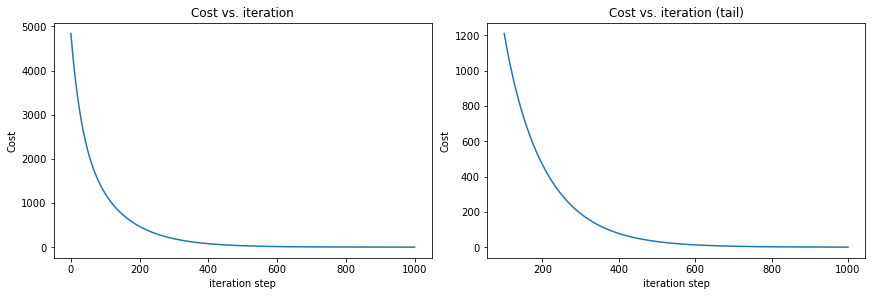

In [28]:
import matplotlib.pyplot as plt
fig, (ax1, ax2) = plt.subplots(1, 2, constrained_layout=True, figsize=(12, 4))
ax1.plot(J_hist)
ax2.plot(100 + np.arange(len(J_hist[100:])), J_hist[100:])
ax1.set_title("Cost vs. iteration");  ax2.set_title("Cost vs. iteration (tail)")
ax1.set_ylabel('Cost')             ;  ax2.set_ylabel('Cost') 
ax1.set_xlabel('iteration step')   ;  ax2.set_xlabel('iteration step') 
plt.show()

In [72]:
y[5]

115.550003

In [29]:
yh = []
yav = []
for i in range(250):
    yh.append(np.dot(X[i],w_final)+b)
    t=y[i]
    yav.append(t)
yh

[120.10647819582582,
 121.88164009912393,
 113.12886193156314,
 112.26593837865492,
 113.80817259947331,
 112.34372175756494,
 113.28950522784305,
 110.38574176089301,
 110.19167713560459,
 110.49469013035437,
 105.94627653130526,
 106.6453888975578,
 108.77861110374249,
 108.22791616691379,
 107.34682239841942,
 107.67471122657636,
 107.81450097964357,
 110.22965006167962,
 110.88070184190907,
 110.13384581262339,
 110.25150410892151,
 110.93942404644147,
 111.96403373535257,
 110.15639623069858,
 108.02565856069961,
 103.63042699532427,
 102.57763439657761,
 105.49142648388855,
 106.02050338221498,
 107.73260609671688,
 108.0444041584765,
 108.24862118749012,
 108.26860154032602,
 109.28008039718381,
 107.69851049087204,
 108.51202082550765,
 110.23515358930892,
 109.91183944949341,
 111.14090662135813,
 112.18248627796679,
 113.32256423173752,
 113.45125954067701,
 112.88746023375211,
 113.33457076888189,
 113.88012367303867,
 113.76204029976145,
 114.75986783085449,
 117.2232386467

In [30]:
ya = np.array(yh)
yar = np.array(yav)

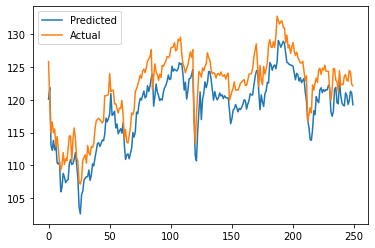

In [31]:
plt.plot(ya, label = "Predicted")#, linestyle="-")
plt.plot(yar, label = "Actual")#, linestyle="--")
#plt.plot(x, np.sin(x), label = "curve 1", linestyle="-.")
#plt.plot(x, np.cos(x), label = "curve 2", linestyle=":")
plt.legend()
plt.show()

In [ ]:
"""
Note : model improves with increased alpha
DOUBT : MODEL IS GIVING ALMOST SIMILAR VLAUES FOR 3 PARAMETERS COULD THAT INDICATE A POSSIBLE ERROR ?
DATASET SIZE : FIRST 10,000 USING OPEN, LOW HIGH AND VOLUME
COST FUNCTIONS :
0.01 = 
0.05 = 
0.08 = 
0.09 = 
0.095 = 
0.1 = 1.27
0.105 = 
0.108 = 